In [ ]:
# !wget http://us.download.nvidia.com/XFree86/Linux-x86_64/440.64/NVIDIA-Linux-x86_64-440.64.runv

In [1]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2018 NVIDIA Corporation
Built on Sat_Aug_25_21:08:01_CDT_2018
Cuda compilation tools, release 10.0, V10.0.130


In [1]:
!nvidia-smi

Thu Mar 19 16:06:10 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.33.01    Driver Version: 440.33.01    CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:01:1F.0 Off |                    0 |
| N/A   35C    P0    41W / 250W |    263MiB / 16280MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [4]:
%%bash
pip uninstall -y torch torchvision
pip install torch==1.2.0 torchvision==0.4.0

# CPU-only version of PyTorch
# pip install torch==1.2.0+cpu torchvision==0.4.0+cpu -f https://download.pytorch.org/whl/torch_stable.html

You should consider upgrading via the 'pip install --upgrade pip' command.


In [ ]:
%%bash
pip install matplotlib==2.1.0 tensorflow==1.15 inflect==0.2.5 librosa==0.6.0 scipy==1.0.0 tensorboardX==1.1 Unidecode==1.0.22 pillow nltk==3.4.5 jamo==0.4.1  music21==5.7.2 vamp > /dev/null
pip install matplotlib==2.1.0 tensorflow==1.15 inflect==0.2.5 librosa==0.6.0 scipy==1.0.0 tensorboardX==1.1 Unidecode==1.0.22 pillow nltk==3.4.5 jamo==0.4.1  music21==5.7.2 vamp 

In [5]:
%%time
%%bash
git clone https://github.com/NVIDIA/apex
cd apex
pip install  --no-cache-dir ./ # only python  

Processing /app/jupyter/apex
  Created wheel for apex: filename=apex-0.1-cp36-none-any.whl size=152761 sha256=722d00a8dddd97eb6596da852b1f0b80536f52b33bf9942ac855300f1e7b0d8c
  Stored in directory: /tmp/pip-ephem-wheel-cache-w7osv6zi/wheels/57/d4/b9/6e10208dc0288c7d566cc2e2137a6901a200eb243b4d43a048
Successfully built apex


fatal: destination path 'apex' already exists and is not an empty directory.
You should consider upgrading via the 'pip install --upgrade pip' command.


CPU times: user 16 ms, sys: 0 ns, total: 16 ms
Wall time: 3.06 s


In [6]:
%%bash
git clone https://github.com/NVIDIA/mellotron.git
cd mellotron
git submodule init
git submodule update

fatal: destination path 'mellotron' already exists and is not an empty directory.


In [7]:
%%bash
apt-get install -y wget
wget -N  -q https://raw.githubusercontent.com/yhgon/colab_utils/master/gfile.py
python gfile.py -u 'https://drive.google.com/open?id=1ZesPPyRRKloltRIuRnGZ2LIUEuMSVjkI' -f 'mellotron_libritts.pt'
python gfile.py -u 'https://drive.google.com/open?id=1Rm5rV5XaWWiUbIpg5385l5sh68z2bVOE' -f 'waveglow_256channels_v4.pt'

Reading package lists...
Building dependency tree...
Reading state information...
The following NEW packages will be installed:
  wget
0 upgraded, 1 newly installed, 0 to remove and 116 not upgraded.
Need to get 316 kB of archives.
After this operation, 954 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/main amd64 wget amd64 1.19.4-1ubuntu2.2 [316 kB]
Fetched 316 kB in 0s (1844 kB/s)
Selecting previously unselected package wget.
(Reading database ... 37671 files and directories currently installed.)
Preparing to unpack .../wget_1.19.4-1ubuntu2.2_amd64.deb ...
Unpacking wget (1.19.4-1ubuntu2.2) ...
Setting up wget (1.19.4-1ubuntu2.2) ...
It took  6.03sec to download 121.9 MB mellotron_libritts.pt 
It took  31.34sec to download 1.3 GB waveglow_256channels_v4.pt 


debconf: delaying package configuration, since apt-utils is not installed


In [35]:
%%file mellotron/hparams.py
import tensorflow as tf
from text.symbols import symbols


def create_hparams(hparams_string=None, verbose=False, mellotron_path='.'):
    """Create model hyperparameters. Parse nondefault from given string."""

    hparams = tf.contrib.training.HParams(
        ################################
        # Experiment Parameters        #
        ################################
        epochs=50000,
        iters_per_checkpoint=500,
        seed=1234,
        dynamic_loss_scaling=True,
        fp16_run=False,
        distributed_run=False,
        dist_backend="nccl",
        dist_url="tcp://localhost:54321",
        cudnn_enabled=True,
        cudnn_benchmark=False,
        ignore_layers=['speaker_embedding.weight'],

        ################################
        # Data Parameters             #
        ################################
        training_files='filelists/ljs_audiopaths_text_sid_train_filelist.txt',
        validation_files='filelists/ljs_audiopaths_text_sid_val_filelist.txt',
        text_cleaners=['english_cleaners'],
        p_arpabet=1.0,
        cmudict_path=f"{mellotron_path}/data/cmu_dictionary",

        ################################
        # Audio Parameters             #
        ################################
        max_wav_value=32768.0,
        sampling_rate=22050,
        filter_length=1024,
        hop_length=256,
        win_length=1024,
        n_mel_channels=80,
        mel_fmin=0.0,
        mel_fmax=8000.0,
        f0_min=80,
        f0_max=880,
        harm_thresh=0.25,

        ################################
        # Model Parameters             #
        ################################
        n_symbols=len(symbols),
        symbols_embedding_dim=512,

        # Encoder parameters
        encoder_kernel_size=5,
        encoder_n_convolutions=3,
        encoder_embedding_dim=512,

        # Decoder parameters
        n_frames_per_step=1,  # currently only 1 is supported
        decoder_rnn_dim=1024,
        prenet_dim=256,
        prenet_f0_n_layers=1,
        prenet_f0_dim=1,
        prenet_f0_kernel_size=1,
        prenet_rms_dim=0,
        prenet_rms_kernel_size=1,
        max_decoder_steps=1000,
        gate_threshold=0.5,
        p_attention_dropout=0.1,
        p_decoder_dropout=0.1,
        p_teacher_forcing=1.0,

        # Attention parameters
        attention_rnn_dim=1024,
        attention_dim=128,

        # Location Layer parameters
        attention_location_n_filters=32,
        attention_location_kernel_size=31,

        # Mel-post processing network parameters
        postnet_embedding_dim=512,
        postnet_kernel_size=5,
        postnet_n_convolutions=5,

        # Speaker embedding
        n_speakers=123,
        speaker_embedding_dim=128,

        # Reference encoder
        with_gst=True,
        ref_enc_filters=[32, 32, 64, 64, 128, 128],
        ref_enc_size=[3, 3],
        ref_enc_strides=[2, 2],
        ref_enc_pad=[1, 1],
        ref_enc_gru_size=128,

        # Style Token Layer
        token_embedding_size=256,
        token_num=10,
        num_heads=8,

        ################################
        # Optimization Hyperparameters #
        ################################
        use_saved_learning_rate=False,
        learning_rate=1e-3,
        learning_rate_min=1e-5,
        learning_rate_anneal=50000,
        weight_decay=1e-6,
        grad_clip_thresh=1.0,
        batch_size=32,
        mask_padding=True,  # set model's padded outputs to padded values

    )

    if hparams_string:
        tf.compat.v1.logging.info('Parsing command line hparams: %s', hparams_string)
        hparams.parse(hparams_string)

    if verbose:
        tf.compat.v1.logging.info('Final parsed hparams: %s', hparams.values())

    return hparams

Overwriting mellotron/hparams.py


In [36]:
%%file mellotron/train_utils.py
import os
import time
import argparse
import math
from numpy import finfo

import torch
#from distributed import apply_gradient_allreduce
import torch.distributed as dist
from torch.utils.data.distributed import DistributedSampler
from torch.utils.data import DataLoader

from model import Tacotron2
from data_utils import TextMelLoader, TextMelCollate
from loss_function import Tacotron2Loss
#from logger import Tacotron2Logger
from hparams import create_hparams


def reduce_tensor(tensor, n_gpus):
    rt = tensor.clone()
    dist.all_reduce(rt, op=dist.ReduceOp.SUM)
    rt /= n_gpus
    return rt


def init_distributed(hparams, n_gpus, rank, group_name):
    assert torch.cuda.is_available(), "Distributed mode requires CUDA."
    print("Initializing Distributed")

    # Set cuda device so everything is done on the right GPU.
    torch.cuda.set_device(rank % torch.cuda.device_count())

    # Initialize distributed communication
    dist.init_process_group(
        backend=hparams.dist_backend, init_method=hparams.dist_url,
        world_size=n_gpus, rank=rank, group_name=group_name)

    print("Done initializing distributed")


def prepare_dataloaders(hparams):
    # Get data, data loaders and collate function ready
    trainset = TextMelLoader(hparams.training_files, hparams)
    valset = TextMelLoader(hparams.validation_files, hparams,
                           speaker_ids=trainset.speaker_ids)
    collate_fn = TextMelCollate(hparams.n_frames_per_step)

    if hparams.distributed_run:
        train_sampler = DistributedSampler(trainset)
        shuffle = False
    else:
        train_sampler = None
        shuffle = True

    train_loader = DataLoader(trainset, num_workers=1, shuffle=shuffle,
                              sampler=train_sampler,
                              batch_size=hparams.batch_size, pin_memory=False,
                              drop_last=True, collate_fn=collate_fn)
    return train_loader, valset, collate_fn, train_sampler


def prepare_directories_and_logger(output_directory, log_directory, rank):
    if rank == 0:
        if not os.path.isdir(output_directory):
            os.makedirs(output_directory)
            os.chmod(output_directory, 0o775)
        logger = None    
        #logger = Tacotron2Logger(os.path.join(output_directory, log_directory))
    else:
        logger = None
    return logger


def load_model(hparams):
    model = Tacotron2(hparams).cuda()
    if hparams.fp16_run:
        model.decoder.attention_layer.score_mask_value = finfo('float16').min

    if hparams.distributed_run:
        model = apply_gradient_allreduce(model)

    return model


def warm_start_model(checkpoint_path, model, ignore_layers):
    assert os.path.isfile(checkpoint_path)
    print("Warm starting model from checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
    model_dict = checkpoint_dict['state_dict']
    if len(ignore_layers) > 0:
        model_dict = {k: v for k, v in model_dict.items()
                      if k not in ignore_layers}
        dummy_dict = model.state_dict()
        dummy_dict.update(model_dict)
        model_dict = dummy_dict
    model.load_state_dict(model_dict)
    return model


def load_checkpoint(checkpoint_path, model, optimizer):
    assert os.path.isfile(checkpoint_path)
    print("Loading checkpoint '{}'".format(checkpoint_path))
    checkpoint_dict = torch.load(checkpoint_path, map_location='cpu')
    model.load_state_dict(checkpoint_dict['state_dict'])
    optimizer.load_state_dict(checkpoint_dict['optimizer'])
    learning_rate = checkpoint_dict['learning_rate']
    iteration = checkpoint_dict['iteration']
    print("Loaded checkpoint '{}' from iteration {}" .format(
        checkpoint_path, iteration))
    return model, optimizer, learning_rate, iteration


def save_checkpoint(model, optimizer, learning_rate, iteration, filepath):
    print("Saving model and optimizer state at iteration {} to {}".format(
        iteration, filepath))
    torch.save({'iteration': iteration,
                'state_dict': model.state_dict(),
                'optimizer': optimizer.state_dict(),
                'learning_rate': learning_rate}, filepath)


def validate(model, criterion, valset, iteration, batch_size, n_gpus,
             collate_fn, logger, distributed_run, rank):
    """Handles all the validation scoring and printing"""
    model.eval()
    with torch.no_grad():
        val_sampler = DistributedSampler(valset) if distributed_run else None
        val_loader = DataLoader(valset, sampler=val_sampler, num_workers=1,
                                shuffle=False, batch_size=batch_size,
                                pin_memory=False, collate_fn=collate_fn)

        val_loss = 0.0
        for i, batch in enumerate(val_loader):
            x, y = model.parse_batch(batch)
            y_pred = model(x)
            loss = criterion(y_pred, y)
            if distributed_run:
                reduced_val_loss = reduce_tensor(loss.data, n_gpus).item()
            else:
                reduced_val_loss = loss.item()
            val_loss += reduced_val_loss
        val_loss = val_loss / (i + 1)

    model.train()
    if rank == 0:
        print("Validation loss {}: {:9f}  ".format(iteration, reduced_val_loss))
        logger.log_validation(val_loss, model, y, y_pred, iteration)


Overwriting mellotron/train_utils.py


In [37]:
%%file mellotron/mellotron_utils.py

import itertools
import re
import numpy as np
import music21 as m21
import torch
import torch.nn.functional as F
from text import text_to_sequence, get_arpabet, cmudict


CMUDICT_PATH = "mellotron/data/cmu_dictionary"
CMUDICT = cmudict.CMUDict(CMUDICT_PATH)
PHONEME2GRAPHEME = {
    'AA': ['a', 'o', 'ah'],
    'AE': ['a', 'e'],
    'AH': ['u', 'e', 'a', 'h', 'o'],
    'AO': ['o', 'u', 'au'],
    'AW': ['ou', 'ow'],
    'AX': ['a'],
    'AXR': ['er'],
    'AY': ['i'],
    'EH': ['e', 'ae'],
    'EY': ['a', 'ai', 'ei', 'e', 'y'],
    'IH': ['i', 'e'],
    'IX': ['e', 'i'],
    'IY': ['ea', 'ey', 'y', 'i'],
    'OW': ['oa'],
    'OY': ['oy'],
    'UH': ['oo'],
    'UW': ['oo', 'u', 'o'],
    'UX': ['u'],
    'B': ['b'],
    'CH': ['ch', 'tch'],
    'D': ['d', 'e', 'de'],
    'DH': ['th'],
    'DX': ['tt'],
    'EL': ['le'],
    'EM': ['m'],
    'EN': ['on'],
    'ER': ['i', 'er'],
    'F': ['f'],
    'G': ['g'],
    'HH': ['h'],
    'JH': ['j'],
    'K': ['k', 'c', 'ch'],
    'KS': ['x'],
    'L': ['ll', 'l'],
    'M': ['m'],
    'N': ['n', 'gn'],
    'NG': ['ng'],
    'NX': ['nn'],
    'P': ['p'],
    'Q': ['-'],
    'R': ['wr', 'r'],
    'S': ['s', 'ce'],
    'SH': ['sh'],
    'T': ['t'],
    'TH': ['th'],
    'V': ['v', 'f', 'e'],
    'W': ['w'],
    'WH': ['wh'],
    'Y': ['y', 'j'],
    'Z': ['z', 's'],
    'ZH': ['s']
}

########################
#  CONSONANT DURATION  #
########################
PHONEMEDURATION = {
    'B': 0.05,
    'CH': 0.1,
    'D': 0.075,
    'DH': 0.05,
    'DX': 0.05,
    'EL': 0.05,
    'EM': 0.05,
    'EN': 0.05,
    'F': 0.1,
    'G': 0.05,
    'HH': 0.05,
    'JH': 0.05,
    'K': 0.05,
    'L': 0.05,
    'M': 0.15,
    'N': 0.15,
    'NG': 0.15,
    'NX': 0.05,
    'P': 0.05,
    'Q': 0.075,
    'R': 0.05,
    'S': 0.1,
    'SH': 0.05,
    'T': 0.075,
    'TH': 0.1,
    'V': 0.05,
    'Y': 0.05,
    'W': 0.05,
    'WH': 0.05,
    'Z': 0.05,
    'ZH': 0.05
}


def add_space_between_events(events, connect=False):
    new_events = []
    for i in range(1, len(events)):
        token_a, freq_a, start_time_a, end_time_a = events[i-1][-1]
        token_b, freq_b, start_time_b, end_time_b = events[i][0]

        if token_a in (' ', '') and len(events[i-1]) == 1:
            new_events.append(events[i-1])
        elif token_a not in (' ', '') and token_b not in (' ', ''):
            new_events.append(events[i-1])
            if connect:
                new_events.append([[' ', 0, end_time_a, start_time_b]])
            else:
                new_events.append([[' ', 0, end_time_a, end_time_a]])
        else:
            new_events.append(events[i-1])

    if len(new_events) > 0 and new_events[-1][0][0] != ' ':
        new_events.append([[' ', 0, end_time_a, end_time_a]])
    new_events.append(events[-1])

    return new_events


def adjust_words(events):
    new_events = []
    for event in events:
        if len(event) == 1 and event[0][0] == ' ':
            new_events.append(event)
        else:
            for e in event:
                if e[0][0].isupper() or len(new_events) == 0:
                    if len(new_events) == 0:
                        e[0] = e[0].capitalize()
                    new_events.append([e])
                else:
                    new_events[-1].extend([e])
    return new_events


def adjust_extensions(events, phoneme_durations):
    if len(events) == 1:
        return events

    idx_last_vowel = None
    n_consonants_after_last_vowel = 0
    target_ids = np.arange(len(events))
    for i in range(len(events)):
        token = re.sub('[0-9{}]', '', events[i][0])
        if idx_last_vowel is None and token not in phoneme_durations:
            idx_last_vowel = i
            n_consonants_after_last_vowel = 0
        else:
            if token == '_' and not n_consonants_after_last_vowel:
                events[i][0] = events[idx_last_vowel][0]
            elif token == '_' and n_consonants_after_last_vowel:
                events[i][0] = events[idx_last_vowel][0]
                start = idx_last_vowel + 1
                target_ids[start:start+n_consonants_after_last_vowel] += 1
                target_ids[i] -= n_consonants_after_last_vowel
            elif token in phoneme_durations:
                n_consonants_after_last_vowel += 1
            else:
                n_consonants_after_last_vowel = 0
                idx_last_vowel = i

    new_events = [0] * len(events)
    for i in range(len(events)):
        new_events[target_ids[i]] = events[i]

    # adjust time of consonants that were repositioned
    for i in range(1, len(new_events)):
        if new_events[i][2] < new_events[i-1][2]:
            new_events[i][2] = new_events[i-1][2]
            new_events[i][3] = new_events[i-1][3]

    return new_events


def adjust_consonant_lengths(events, phoneme_durations):
    t_init = events[0][2]

    idx_last_vowel = None
    for i in range(len(events)):
        task = re.sub('[0-9{}]', '', events[i][0])
        if task in phoneme_durations:
            duration = phoneme_durations[task]
            if idx_last_vowel is None:  # consonant comes before any vowel
                events[i][2] = t_init
                events[i][3] = t_init + duration
            else:  # consonant comes after a vowel, must offset
                events[idx_last_vowel][3] -= duration
                for k in range(idx_last_vowel+1, i):
                    events[k][2] -= duration
                    events[k][3] -= duration
                events[i][2] = events[i-1][3]
                events[i][3] = events[i-1][3] + duration
        else:
            events[i][2] = t_init
            events[i][3] = events[i][3]
            t_init = events[i][3]
            idx_last_vowel = i
        t_init = events[i][3]

    return events


def adjust_consonants(events, phoneme_durations):
    if len(events) == 1:
        return events

    start = 0
    split_ids = []
    t_init = events[0][2]

    # get each substring group
    for i in range(1, len(events)):
        if events[i][2] != t_init:
            split_ids.append((start, i))
            start = i
            t_init = events[i][2]
    split_ids.append((start, len(events)))

    for (start, end) in split_ids:
        events[start:end] = adjust_consonant_lengths(
            events[start:end], phoneme_durations)

    return events


def adjust_event(event, hop_length=256, sampling_rate=22050):
    tokens, freq, start_time, end_time = event

    if tokens == ' ':
        return [event] if freq == 0 else [['_', freq, start_time, end_time]]

    return [[token, freq, start_time, end_time] for token in tokens]


def musicxml2score(filepath, bpm=60):
    track = {}
    beat_length_seconds = 60/bpm
    data = m21.converter.parse(filepath)
    for i in range(len(data.parts)):
        part = data.parts[i].flat
        events = []
        for k in range(len(part.notesAndRests)):
            event = part.notesAndRests[k]
            if isinstance(event, m21.note.Note):
                freq = event.pitch.frequency
            elif isinstance(event, m21.chord.Chord):
                freqs = [note.pitch.frequency for note in event.notes]
                freq = sum(freqs) / len(freqs)  # we average pitches
            elif isinstance(event, m21.note.Rest):
                freq = 0
                # token = ' '

            token = event.lyrics[0].text if len(event.lyrics) > 0 else ' '

            start_time = event.offset * beat_length_seconds
            end_time = start_time + event.duration.quarterLength * beat_length_seconds
            event = [token, freq, start_time, end_time]

            if token == '_':
                raise Exception("Unexpected token {}".format(token))

            if len(events) == 0:
                events.append(event)
            else:
                if token == ' ':
                    if freq == 0:
                        if events[-1][1] == 0:
                            events[-1][3] = end_time
                        else:
                            events.append(event)
                    elif freq == events[-1][1]:  # is event duration extension ?
                        events[-1][-1] = end_time
                    else:  # must be different note on same syllable
                        events.append(event)
                else:
                    events.append(event)
        track[part.partName] = events
    return track


def track2events(track):
    events = []
    for e in track:
        events.extend(adjust_event(e))
    group_ids = [i for i in range(len(events))
                 if events[i][0] in [' '] or events[i][0].isupper()]

    events_grouped = []
    for i in range(1, len(group_ids)):
        start, end = group_ids[i-1], group_ids[i]
        events_grouped.append(events[start:end])

    if events[-1][0] != ' ':
        events_grouped.append(events[group_ids[-1]:])

    return events_grouped


def events2eventsarpabet(event):
    if event[0][0] == ' ':
        return event

    # get word and word arpabet
    word = ''.join([e[0] for e in event if e[0] not in('_', ' ')])
    word_arpabet = get_arpabet(word, CMUDICT)
    if word_arpabet[0] != '{':
        return event

    word_arpabet = word_arpabet.split()
    # print(word_arpabet, event)

    # align tokens to arpabet
    i, k = 0, 0
    new_events = []
    while i < len(event) and k < len(word_arpabet):
        # single token
        token_a, freq_a, start_time_a, end_time_a = event[i]

        if token_a == ' ':
            new_events.append([token_a, freq_a, start_time_a, end_time_a])
            i += 1
            continue

        if token_a == '_':
            new_events.append([token_a, freq_a, start_time_a, end_time_a])
            i += 1
            continue

        # two tokens
        if i < len(event) - 1:
            j = i + 1
            token_b, freq_b, start_time_b, end_time_b = event[j]
            between_events = []
            while j < len(event) and event[j][0] == '_':
                between_events.append([token_b, freq_b, start_time_b, end_time_b])
                j += 1
                if j < len(event):
                    token_b, freq_b, start_time_b, end_time_b = event[j]

            token_compound_2 = (token_a + token_b).lower()

        # single arpabet
        arpabet = re.sub('[0-9{}]', '', word_arpabet[k])

        arpabet_compound_2 = ''.join(word_arpabet[k:min(k+2, len(word_arpabet))])
        arpabet_compound_2 = re.sub('[0-9{}]', '', arpabet_compound_2)
        # print(word_arpabet, arpabet_compound_2)

        if i < len(event) - 1 and token_compound_2 in PHONEME2GRAPHEME[arpabet]:
            new_events.append([word_arpabet[k], freq_a, start_time_a, end_time_a])
            if len(between_events):
                new_events.extend(between_events)
            if start_time_a != start_time_b:
                new_events.append([word_arpabet[k], freq_b, start_time_b, end_time_b])
            i += 2 + len(between_events)
            k += 1
        elif token_a.lower() in PHONEME2GRAPHEME[arpabet]:
            new_events.append([word_arpabet[k], freq_a, start_time_a, end_time_a])
            i += 1
            k += 1
        elif arpabet_compound_2 in PHONEME2GRAPHEME and token_a.lower() in PHONEME2GRAPHEME[arpabet_compound_2]:
            new_events.append([word_arpabet[k], freq_a, start_time_a, end_time_a])
            new_events.append([word_arpabet[k+1], freq_a, start_time_a, end_time_a])
            i += 1
            k += 2
        else:
            k += 1

    if len(event) == 1:
        if len(word_arpabet) > 1:
            raise Exception("More characters in {} than in {}".format(word, word_arpabet))
        token_a, freq_a, start_time_a, end_time_a = event[0]
        new_events.append([word_arpabet[0], freq_a, start_time_a, end_time_a])

    # add extensions and pauses at end of words
    while i < len(event):
        token_a, freq_a, start_time_a, end_time_a = event[i]

        if token_a in (' ', '_'):
            new_events.append([token_a, freq_a, start_time_a, end_time_a])
        i += 1

    # Krzysztof's hack, not sure if it is a proper approach though :-/
    if len(new_events) != len(event) or len(new_events) == 0 or new_events[-1][0][-1] != '}':
        print("[STATS]", word, word_arpabet, len(word_arpabet), len(event), len(new_events))
        print("[OLD] ", new_events)

        new_events_fixed = []
        for new_token, old_event, new_event in itertools.zip_longest(word_arpabet, event, new_events):
            if new_event is not None:
                _, freq_a, start_time_a, end_time_a = new_event
            elif old_event is not None:
                _, freq_a, start_time_a, end_time_a = old_event
            else:
                raise RuntimeError("too short events list")
            if new_token is not None:
                new_events_fixed.append([new_token, freq_a, start_time_a, end_time_a])
        new_events = new_events_fixed
        print("[NEW] ", new_events)

    if len(new_events) == 0:
        print("\t[ZERO]", event, new_events)
    elif new_events[-1][0][-1] != "}":
        print("\t[NO BRACKET]", event, new_events)

    return new_events


def event2alignment(events, hop_length=256, sampling_rate=22050):
    frame_length = float(hop_length) / float(sampling_rate)

    n_frames = int(events[-1][-1][-1] / frame_length)
    n_tokens = np.sum([len(e) for e in events])
    alignment = np.zeros((n_tokens, n_frames))

    cur_event = -1
    for event in events:
        for i in range(len(event)):
            if len(event) == 1 or cur_event == -1 or event[i][0] != event[i-1][0]:
                cur_event += 1
            token, freq, start_time, end_time = event[i]
            alignment[cur_event, int(start_time/frame_length):int(end_time/frame_length)] = 1

    return alignment[:cur_event+1]


def event2f0(events, hop_length=256, sampling_rate=22050):
    frame_length = float(hop_length) / float(sampling_rate)
    n_frames = int(events[-1][-1][-1] / frame_length)
    f0s = np.zeros((1, n_frames))

    for event in events:
        for i in range(len(event)):
            token, freq, start_time, end_time = event[i]
            f0s[0, int(start_time/frame_length):int(end_time/frame_length)] = freq

    return f0s


def event2text(events, convert_stress, cmudict=CMUDICT):
    text_clean = ''
    for event in events:
        for i in range(len(event)):
            if i > 0 and event[i][0] == event[i-1][0]:
                continue
            if event[i][0] == ' ' and len(event) > 1:
                if len(text_clean) > 0 and text_clean[-1] != "}":
                    text_clean = text_clean[:-1] + '} {'
                else:
                    text_clean += ' {'
            else:
                if event[i][0][-1] in ('}', ' '):
                    text_clean += event[i][0]
                else:
                    text_clean += event[i][0] + ' '

    if convert_stress:
        text_clean = re.sub('[0-9]', '1', text_clean.strip())

    text_encoded = text_to_sequence(text_clean.strip(), [], cmudict)

    return text_encoded, text_clean.strip()


def remove_excess_frames(alignment, f0s):
    excess_frames = np.sum(alignment.sum(0) == 0)
    alignment = alignment[:, :-excess_frames] if excess_frames > 0 else alignment
    f0s = f0s[:, :-excess_frames] if excess_frames > 0 else f0s
    return alignment, f0s


def get_data_from_musicxml(filepath_or_score, bpm, phoneme_durations=None,
                           convert_stress=False):

    if isinstance(filepath_or_score, str):
        score = musicxml2score(filepath_or_score, bpm)
    else:
        score = filepath_or_score

    if phoneme_durations is None:
        phoneme_durations = PHONEMEDURATION

    data = {}
    for k, v in score.items():
        # ignore empty tracks
        if len(v) == 1 and v[0][0] == ' ':
            continue

        events = track2events(v)
        events = adjust_words(events)

        events_arpabet = []
        for e in events:
            ea = events2eventsarpabet(e)
            if len(ea) > 0:
                events_arpabet.append(ea)

        for idx, e in enumerate(events_arpabet):
            if len(e) == 0:
                raise RuntimeError(f"Zero-length event at index {idx}")

        print("[STEP 0]", events_arpabet)

        # make adjustments
        events_arpabet = [adjust_extensions(e, phoneme_durations)
                          for e in events_arpabet]
        print("[STEP 1]", events_arpabet)
        events_arpabet = [adjust_consonants(e, phoneme_durations)
                          for e in events_arpabet]
        print("[STEP 2]", events_arpabet)
        events_arpabet = add_space_between_events(events_arpabet)
        print("[STEP 3]", events_arpabet)

        # convert data to alignment, f0 and text encoded
        alignment = event2alignment(events_arpabet)
        f0s = event2f0(events_arpabet)
        alignment, f0s = remove_excess_frames(alignment, f0s)
        text_encoded, text_clean = event2text(events_arpabet, convert_stress)
        print(text_clean)

        # convert data to torch
        alignment = torch.from_numpy(alignment).permute(1, 0)[:, None].float()
        f0s = torch.from_numpy(f0s)[None].float()
        text_encoded = torch.LongTensor(text_encoded)[None]
        data[k] = {'rhythm': alignment,
                   'pitch_contour': f0s,
                   'text_encoded': text_encoded}

    return data


def ai_song_contest_lyrics_preprocessing():

    lyrics = """
        It pains me to say... you made my life so much more. . What an impossible dream. I can't imagine what will happen. . So many people that I know. All I could ever imagine. To be like you. . What am I all wrong??. Oh... what am I all wrong?. . What am I all wrong?. Oh... what am I all wrong?. . So many people that I know. All I can ever imagine. To be like you. . What am I all wrong?. Oh... what am I all wrong?."All I can ever imagine (All I can imagine). To be like you. . What am I all wrong?. Oh... what am I all wrong?. . So many people that I know. All I can ever imagine. To be like you. . What am I all wrong?. Ah... what am I all wrong?. . So many people that I know. All I can ever imagine. To be like you
        
        I could stay or go. I could go any time I wanted. I could always get away. I could get out of my head. I could never ever stop thinking. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . A million stars, a million days. I can only pray that someday. I can go any time I want. I can always get away. I could never ever stop thinking. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . Oh my heart beat and shakes. It's like a million angels. That I pray to keep. . Oh my heart is beating with love and hope. It's like a million angels. That I pray to keep. . Oh my heart beats and shakes. It's like a million angels. That I pray to keep. . Oh my heart beats and shakes. It's like a million angels. That I pray to keep. . It's that very same feeling. That the stars really are blue. And I pray to keep. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad
        
        You're taking me to another dimension. Every time you touch me. I feel what I need. The gravity is real. . I knew we were nothing. All that we could be. But I knew all that we could be. . But I knew we couldn't make anything else go away. It feels so good to see you. . I can't help but smile, I gotta see how that is. And I know that
    """

    import hyphen

    import nltk
    nltk.download('punkt')

    # from nltk.tokenize import SyllableTokenizer
    from nltk import word_tokenize

    lang = 'en_US'
    if not hyphen.dictools.is_installed(lang):
        hyphen.dictools.install(lang)

    hyph = hyphen.Hyphenator(lang)
    print([hyph.syllables(word) for word in nltk.word_tokenize('people')])

    syllables = []
    for word in nltk.word_tokenize(lyrics):
      if word in ("n't", "'s"):  # e.g. can't doesn't it's
        syllables[-1] += word
        # pass
      elif word.isalpha():
        syls = hyph.syllables(word)
        if len(syls) == 0:
          syls = [word]
        syls[0] = syls[0].capitalize()
        syllables += syls

    print(syllables)

    return syllables


if __name__ == "__main__":
    import argparse
    # Get defaults so it can work with no Sacred
    # parser = argparse.ArgumentParser()
    # parser.add_argument('-f', "--filepath", required=True)
    # args = parser.parse_args()


    syllables = ai_song_contest_lyrics_preprocessing()


    # args = {'filepath': 'data/haendel_hallelujah.musicxml'}
    # args = {'filepath': 'data/haendel_hallelujah_3.musicxml'}
    args = {'filepath': 'data/ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml'}

    score = musicxml2score(args['filepath'], bpm=147)

    # for k, v in score.items():
    #     v[0][0] = 'God'
    #     v[1][0] = ' '
    #     v[2][0] = ' '
    #     v[3][0] = ' '

    # for idx, entry in enumerate(score['Voice']):
    for track in score.keys():
        for idx, entry in enumerate(score[track]):
            if idx < len(syllables):
                entry[0] = syllables[idx]
                score[track][idx] = entry

    for k, v in score.items():
        print(k, len(v), v)

    data1 = get_data_from_musicxml(score, 147)
    for track, entries in data1.items():
        print(track, [(k, v.shape) for k, v in entries.items()])

    data0 = get_data_from_musicxml(args['filepath'], 147)
    for track, entries in data0.items():
        print(track, [(k, v.shape) for k, v in entries.items()])

    # track = 'Soprano'
    track = 'Piano'
    print(data0[track]['text_encoded'])
    print(data1[track]['text_encoded'])


Overwriting mellotron/mellotron_utils.py


In [13]:
# !pip install --upgrade librosa
!pip uninstall -y numpy
!pip install numpy==1.17.1

import librosa
librosa.__version__

'0.6.0'

In [14]:
!pip install hparams

You should consider upgrading via the 'pip install --upgrade pip' command.


In [38]:
MELLOTRON_PATH = '/app/jupyter/mellotron'

In [39]:
%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import IPython.display as ipd

import sys
################################################################################################

# IT IS IMPORTANT TO HAVE THESE PATHS BEFORE /app/utils !!!
sys.path.insert(0, f'{MELLOTRON_PATH}/')             #####  modified for  colab ######
sys.path.insert(0, f'{MELLOTRON_PATH}/waveglow/')   #####  modified for  colab ######
sys.path.insert(0, f'{MELLOTRON_PATH}/data')   #####  modified for  colab ######
sys.path.insert(0, f'{MELLOTRON_PATH}/data/cmu_dictionary')   #####  modified for  colab ######
################################################################################################

from itertools import cycle
import numpy as np
import scipy as sp
from scipy.io.wavfile import write
import pandas as pd
import librosa
import torch

from hparams import create_hparams
from model import Tacotron2
from waveglow.denoiser import Denoiser
from layers import TacotronSTFT
################################################################################################
from train_utils import load_model #####  modified for inference  on colab #####################
################################################################################################
from data_utils import TextMelLoader, TextMelCollate
from text import cmudict, text_to_sequence
from mellotron_utils import get_data_from_musicxml

In [40]:
def panner(signal, angle):
    angle = np.radians(angle)
    left = np.sqrt(2)/2.0 * (np.cos(angle) - np.sin(angle)) * signal
    right = np.sqrt(2)/2.0 * (np.cos(angle) + np.sin(angle)) * signal
    return np.dstack((left, right))[0]

def plot_mel_f0_alignment(mel_source, mel_outputs_postnet, f0s, alignments, figsize=(16, 16)):
    fig, axes = plt.subplots(4, 1, figsize=figsize)
    axes = axes.flatten()
    axes[0].imshow(mel_source, aspect='auto', origin='bottom', interpolation='none')
    axes[1].imshow(mel_outputs_postnet, aspect='auto', origin='bottom', interpolation='none')
    axes[2].scatter(range(len(f0s)), f0s, alpha=0.5, color='red', marker='.', s=1)
    axes[2].set_xlim(0, len(f0s))
    axes[3].imshow(alignments, aspect='auto', origin='bottom', interpolation='none')
    axes[0].set_title("Source Mel")
    axes[1].set_title("Predicted Mel")
    axes[2].set_title("Source pitch contour")
    axes[3].set_title("Source rhythm")
    plt.tight_layout()

def load_mel(path):
    audio, sampling_rate = librosa.core.load(path, sr=hparams.sampling_rate)
    audio = torch.from_numpy(audio)
    if sampling_rate != hparams.sampling_rate:
        raise ValueError("{} SR doesn't match target {} SR".format(
            sampling_rate, stft.sampling_rate))
    audio_norm = audio / hparams.max_wav_value
    audio_norm = audio_norm.unsqueeze(0)
    audio_norm = torch.autograd.Variable(audio_norm, requires_grad=False)
    melspec = stft.mel_spectrogram(audio_norm)
    melspec = melspec.cuda()
    return melspec

In [41]:
hparams = create_hparams(mellotron_path=MELLOTRON_PATH)

W0323 10:43:36.925113 139643519305536 lazy_loader.py:50] 
The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [42]:
stft = TacotronSTFT(hparams.filter_length, hparams.hop_length, hparams.win_length,
                    hparams.n_mel_channels, hparams.sampling_rate, hparams.mel_fmin,
                    hparams.mel_fmax)

In [43]:
import torch
from layers import STFT

class Denoiser(torch.nn.Module):
    """ Removes model bias from audio produced with waveglow """

    def __init__(self, waveglow, filter_length=1024, n_overlap=4,
                 win_length=1024, mode='zeros'):
        super(Denoiser, self).__init__()
        
        self.device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        
        self.stft = STFT(filter_length=filter_length,
                         hop_length=int(filter_length/n_overlap),
                         win_length=win_length).to(self.device)  # replace each .cuda() with .to(device)
        
        if mode == 'zeros':
            mel_input = torch.zeros(
                (1, 80, 88),
                dtype=waveglow.upsample.weight.dtype,
                device=waveglow.upsample.weight.device)
        elif mode == 'normal':
            mel_input = torch.randn(
                (1, 80, 88),
                dtype=waveglow.upsample.weight.dtype,
                device=waveglow.upsample.weight.device)
        else:
            raise Exception("Mode {} if not supported".format(mode))

        with torch.no_grad():
            bias_audio = waveglow.infer(mel_input, sigma=0.0).float()
            bias_spec, _ = self.stft.transform(bias_audio)

        self.register_buffer('bias_spec', bias_spec[:, :, 0][:, :, None])

    def forward(self, audio, strength=0.1):
        audio_spec, audio_angles = self.stft.transform(audio.to(self.device).float())  # replace each .cuda() with .to(device)
        audio_spec_denoised = audio_spec - self.bias_spec * strength
        audio_spec_denoised = torch.clamp(audio_spec_denoised, 0.0)
        audio_denoised = self.stft.inverse(audio_spec_denoised, audio_angles)
        return audio_denoised

In [44]:
cpu_only_mode = False

In [45]:
checkpoint_path = "mellotron_libritts.pt"

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')  # replace each .cuda() with .to(device)

if cpu_only_mode: 
    tacotron = load_model(hparams, map_location=lambda storage, loc: storage).eval()
else:
    tacotron = load_model(hparams).to(device).eval()

tacotron.load_state_dict(torch.load(checkpoint_path)['state_dict'])

<All keys matched successfully>

In [46]:
waveglow_path = 'waveglow_256channels_v4.pt'

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')  # replace each .cuda() with .to(device)

if cpu_only_mode: 
    waveglow = torch.load(waveglow_path, map_location=lambda storage, loc: storage)['model'].to(device).eval()
    denoiser = Denoiser(waveglow).to(device).eval()
else:
    waveglow = torch.load(waveglow_path)['model'].cuda().eval()
    denoiser = Denoiser(waveglow).cuda().eval()

In [47]:
%%file mellotron/data/examples_filelist.txt
mellotron/data/example1.wav|exploring the expanses of space to keep our planet safe|1
mellotron/data/example2.wav|and all the species that call it home|1

Overwriting mellotron/data/examples_filelist.txt


In [48]:
arpabet_dict = cmudict.CMUDict(f'{MELLOTRON_PATH}/data/cmu_dictionary')
audio_paths = f'{MELLOTRON_PATH}/data/examples_filelist.txt'
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)

In [49]:
file_idx = 0
audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]

# get audio path, encoded text, pitch contour and mel for gst
text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
pitch_contour = dataloader[file_idx][3][None].cuda()
mel = load_mel(audio_path)
print(audio_path, text)

# load source data to obtain rhythm using tacotron 2 as a forced aligner
x, y = tacotron.parse_batch(datacollate([dataloader[file_idx]]))

mellotron/data/example1.wav exploring the expanses of space to keep our planet safe


In [50]:
ipd.Audio(audio_path, rate=hparams.sampling_rate)

In [187]:
speaker_ids = TextMelLoader(f"{MELLOTRON_PATH}/filelists/libritts_train_clean_100_audiopath_text_sid_atleast5min_val_filelist.txt", hparams).speaker_ids
speakers = pd.read_csv(f'{MELLOTRON_PATH}/filelists/libritts_speakerinfo.txt', engine='python',header=None, comment=';', sep=' *\| *', 
                       names=['ID', 'SEX', 'SUBSET', 'MINUTES', 'NAME'])
speakers['MELLOTRON_ID'] = speakers['ID'].apply(lambda x: speaker_ids[x] if x in speaker_ids else -1)
female_speakers = cycle(
    speakers.query("SEX == 'F' and MINUTES > 20 and MELLOTRON_ID >= 0")['MELLOTRON_ID'].sample(frac=1).tolist())
male_speakers = cycle(
    speakers.query("SEX == 'M' and MINUTES > 20 and MELLOTRON_ID >= 0")['MELLOTRON_ID'].sample(frac=1).tolist())

In [52]:
with torch.no_grad():
    # get rhythm (alignment map) using tacotron 2
    mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = tacotron.forward(x)
    rhythm = rhythm.permute(1, 0, 2)

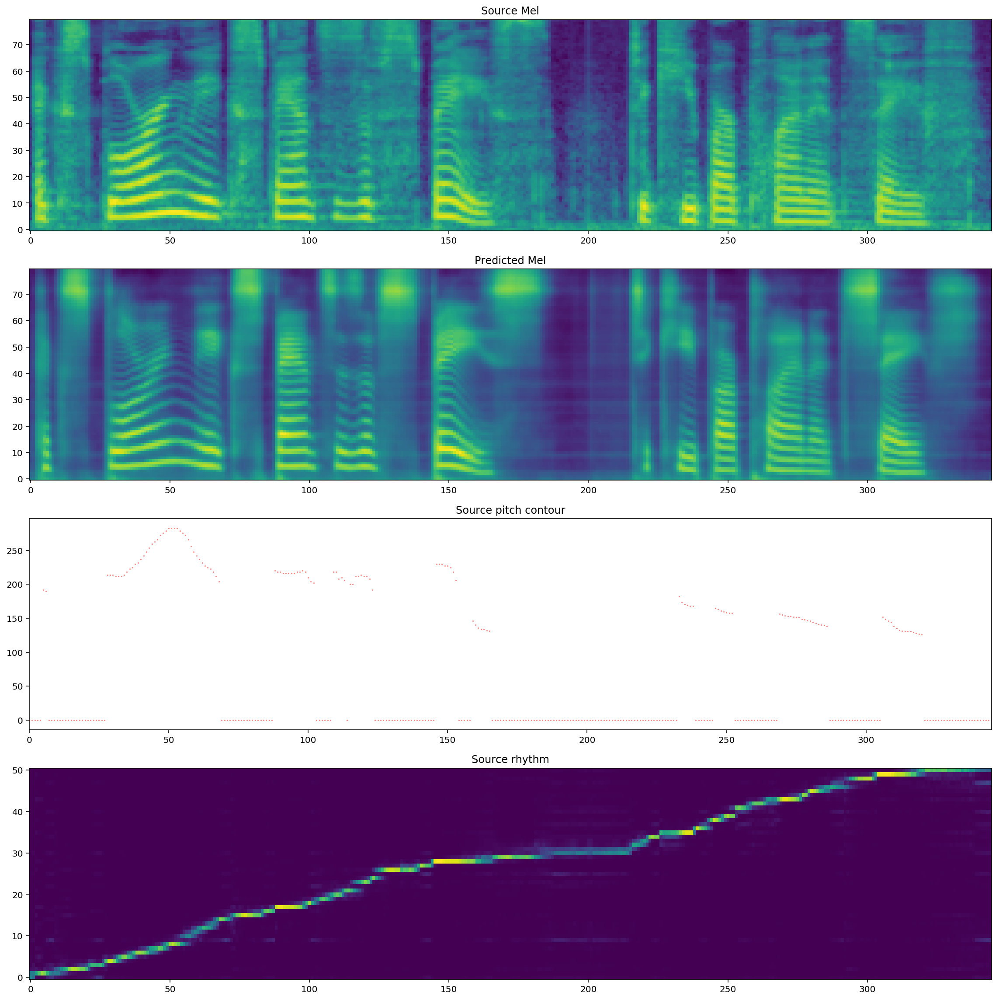

In [53]:
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = tacotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)

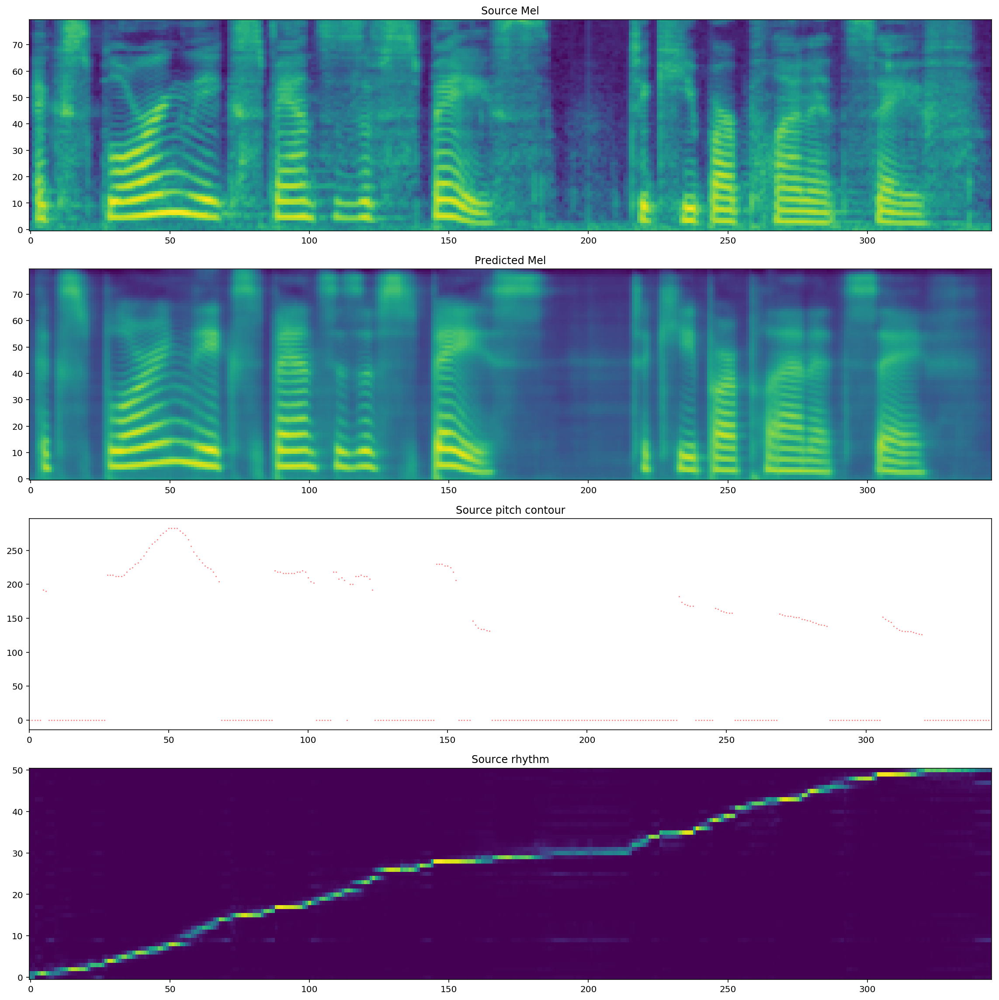

In [54]:
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = tacotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
                      mel_outputs_postnet.data.cpu().numpy()[0],
                      pitch_contour.data.cpu().numpy()[0, 0],
                      rhythm.data.cpu().numpy()[:, 0].T)

In [19]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.8), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

# Lyrics preprocessing

In [17]:
! pip install pyhyphen

  Created wheel for pyhyphen: filename=PyHyphen-3.0.1-cp36-cp36m-linux_x86_64.whl size=63259 sha256=8c9e507eaab92fd7c69e662f86aa85eb6e038ba2fc88d8b7856077cabab7cfc9
  Stored in directory: /root/.cache/pip/wheels/85/46/93/46c556b5f054568b7470c86c4f76ea628a9a8bdf5a355b9c63
Successfully built pyhyphen
You should consider upgrading via the 'pip install --upgrade pip' command.


In [68]:
import nltk

nltk.download('punkt')

from nltk import word_tokenize

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [69]:
import hyphen
 
lang = 'en_US'
if not hyphen.dictools.is_installed(lang): 
  hyphen.dictools.install(lang)

hyph = hyphen.Hyphenator(lang)
print([hyph.syllables(word) for word in word_tokenize('people')])

[['peo', 'ple']]


In [22]:
# !pip install --upgrade nltk==3.5b1

# nltk.download('punkt')

# from nltk.tokenize import SyllableTokenizer
# from nltk import word_tokenize

# ssp = SyllableTokenizer()
# print(ssp.tokenize('justification'))

# text = "This is a foobar-like sentence. Imagine people"
# print([ssp.tokenize(token) for token in word_tokenize(text)])

In [170]:
lyrics = """
It pains me to say... you made my life so much more. . What an impossible dream. I can't imagine what will happen. . So many people that I know. All I could ever imagine. To be like you. . What am I all wrong??. Oh... what am I all wrong?. . What am I all wrong?. Oh... what am I all wrong?. So many people that I know. All I can ever imagine. To be like you. . What am I all wrong?. Oh... what am I all wrong?.
All I can ever imagine (All I can imagine). To be like you. . What am I all wrong?. Oh... what am I all wrong?. . So many people that I know. All I can ever imagine. To be like you. . What am I all wrong?. Ah... what am I all wrong?. . So many people that I know. All I can ever imagine. To be like you
I could stay or go. I could go any time I wanted. I could always get away. I could get out of my head. I could never ever stop thinking. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. 
A million stars, a million days. I can only pray that someday. I can go any time I want. I can always get away. I could never ever stop thinking. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. 
Oh my heart beat and shakes. It's like a million angels. That I pray to keep. . Oh my heart is beating with love and hope. It's like a million angels. That I pray to keep. . Oh my heart beats and shakes. It's like a million angels. That I pray to keep. . Oh my heart beats and shakes. It's like a million angels. That I pray to keep. . It's that very same feeling. That the stars really are blue. And I pray to keep. 
I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad. . I could feel the time is right. I could feel the heart is still blue. The love that I think I need. It makes me sad
You're taking me to another dimension. Every time you touch me. I feel what I need. The gravity is real. . I knew we were nothing. All that we could be. But I knew all that we could be. . But I knew we couldn't make anything else go away. It feels so good to see you. . I can't help but smile, I gotta see how that is. And I know that
"""

In [71]:
syllables = []
for word in word_tokenize(lyrics):
  if word in ("n't", "'s"):  # e.g. can't doesn't it's
    syllables[-1] += word
  elif word.isalpha():
    syls = hyph.syllables(word)
    if len(syls) == 0:
      syls = [word]
    syls[0] = syls[0].capitalize()
    # syllables += syls
    syllables.append('-'.join(syls))

print(' '.join(syllables))

It Pains Me To Say You Made My Life So Much More What An Im-pos-si-ble Dream I Can't Imag-ine What Will Hap-pen So Many Peo-ple That I Know All I Could Ever Imag-ine To Be Like You What Am I All Wrong Oh What Am I All Wrong What Am I All Wrong Oh What Am I All Wrong So Many Peo-ple That I Know All I Can Ever Imag-ine To Be Like You What Am I All Wrong Oh What Am I All Wrong All I Can Ever Imag-ine All I Can Imag-ine To Be Like You What Am I All Wrong Oh What Am I All Wrong So Many Peo-ple That I Know All I Can Ever Imag-ine To Be Like You What Am I All Wrong Ah What Am I All Wrong So Many Peo-ple That I Know All I Can Ever Imag-ine To Be Like You I Could Stay Or Go I Could Go Any Time I Wanted I Could Al-ways Get Away I Could Get Out Of My Head I Could Never Ever Stop Think-ing I Could Feel The Time Is Right I Could Feel The Heart Is Still Blue The Love That I Think I Need It Makes Me Sad I Could Feel The Time Is Right I Could Feel The Heart Is Still Blue The Love That I Think I Need I

# LYRICS TO SINGING

In [ ]:
!apt-get install -y libsndfile1 libsndfile1-dev
!pip install pysndfile

In [ ]:
!pip install librosa
!pip install pydub
!pip install gtts

In [207]:
# lyrics_oneline = lyrics.strip().replace('\n', ' ')
# with open('mellotron/data/examples_filelist.txt', 'wt') as f:
#     f.write(f"/app/jupyter/tts.wav|{lyrics_oneline}|2\n")
#     f.write(f"/app/jupyter/tts-Copy1.wav|{lyrics_oneline}|2\n")

# lyrics_20sec = "It pains me to say... you made my life so much more. . What an impossible dream. I can't imagine what will happen. . So many people that I know. All I could ever imagine. To be like you. . What am I all wrong??. Oh... what am I all wrong?. . What am I all wrong?. Oh... what am I all wrong?."
# with open('mellotron/data/examples_filelist.txt', 'wt') as f:
#     f.write(f"/app/jupyter/tts_20s.wav|{lyrics_20sec}|1\n")
#     f.write(f"/app/jupyter/tts_20s-Copy1.wav|{lyrics_20sec}|1\n")

import utils_audio as ua

import importlib
importlib.reload(ua)

speaker_id = 3
# speaker_id = next(female_speakers)
# speaker_id = next(male_speakers)
print(f"Speaker_id = {speaker_id}")

wavfiles = ua.create_mellotron_input_from_lyrics_lines(lyrics, speaker_id=speaker_id)

Speaker_id = 3


In [208]:
arpabet_dict = cmudict.CMUDict(f'{MELLOTRON_PATH}/data/cmu_dictionary')
audio_paths = f'{MELLOTRON_PATH}/data/examples_filelist.txt'
dataloader = TextMelLoader(audio_paths, hparams)
datacollate = TextMelCollate(1)

In [209]:
def process_audio_part(file_idx, musicxml_input='output_fast.musicxml', bpm=100, track='Piano'):
    audio_path, text, sid = dataloader.audiopaths_and_text[file_idx]
    print(audio_path, len(text), sid)

    # get audio path, encoded text, pitch contour and mel for gst
    text_encoded = torch.LongTensor(text_to_sequence(text, hparams.text_cleaners, arpabet_dict))[None, :].cuda()    
    pitch_contour = dataloader[file_idx][3][None].cuda()
    mel = load_mel(audio_path)

    # load source data to obtain rhythm using tacotron 2 as a forced aligner
    x, y = tacotron.parse_batch(datacollate([dataloader[file_idx]]))
    
    # get rhythm (alignment map) using tacotron 2
    with torch.no_grad():
        mel_outputs, mel_outputs_postnet, gate_outputs, rhythm = tacotron.forward(x)
        rhythm = rhythm.permute(1, 0, 2)
        
    score = mu.musicxml2score(musicxml_input, bpm=bpm)
    
    f0s = mu.event2f0([score[track]])
    f0s = torch.from_numpy(f0s)[None].float()
    print(f0s.shape)
    
    alignment = mu.event2alignment([score[track]])
    alignment = torch.from_numpy(alignment).permute(1, 0)[:, None].float()
    print(alignment.shape)
    
    # rhythm = data[part]['rhythm'].cuda()
    # rhythm = alignment.cuda()

    # pitch_contour = data[part]['pitch_contour'].cuda()
    pitch_contour = f0s.cuda()

    print(text_encoded.shape, rhythm.shape, pitch_contour.shape)

    # rhythm = rhythm[:, :, :min(text_encoded.shape[-1], rhythm.shape[-1])]
    # print(text_encoded.shape, rhythm.shape, pitch_contour.shape)
    
    speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
    speaker_id = torch.LongTensor([speaker_id]).cuda()

    with torch.no_grad():
        mel_outputs, mel_outputs_postnet, gate_outputs, _ = tacotron.inference_noattention(
            (text_encoded, mel, speaker_id, pitch_contour, rhythm))

    # plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
    #                       mel_outputs_postnet.data.cpu().numpy()[0],
    #                       pitch_contour.data.cpu().numpy()[0, 0],
    #                       rhythm.data.cpu().numpy()[:, 0].T)
    
    with torch.no_grad():
        audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.8), 0.01)[:, 0]
        
    return audio

In [216]:
# musicxml_input = 'input/haendel_hallelujah.musicxml'
# track = 'Bass'

# musicxml_input = 'input/ABBA_-_Dancing_Queen.musicxml'
# score = mu.musicxml2score('input/ABBA_-_Dancing_Queen.musicxml', 100)
# print(score.keys())
# track = 'Voice'
# track = 'Piano'

musicxml_input = 'results/midi/output_moving_window.musicxml'
track = 'Piano'


sing_parts = {}
for idx, wavfile in enumerate(wavfiles):
    audio_path, text, sid = dataloader.audiopaths_and_text[idx]
    audio = process_audio_part(file_idx=idx, musicxml_input=musicxml_input, bpm=120, track=track)
    audio_data = audio[0].data.cpu().numpy()
    sing_parts[audio_path] = audio_data
    display(ipd.Audio(audio_data, rate=hparams.sampling_rate))

/app/jupyter/tts_01.wav 302 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 283]) torch.Size([2140, 1, 283]) torch.Size([1, 1, 26873])


/app/jupyter/tts_02.wav 375 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 327]) torch.Size([2407, 1, 327]) torch.Size([1, 1, 26873])


/app/jupyter/tts_05.wav 353 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 305]) torch.Size([2227, 1, 305]) torch.Size([1, 1, 26873])


/app/jupyter/tts_04.wav 417 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 373]) torch.Size([2905, 1, 373]) torch.Size([1, 1, 26873])


/app/jupyter/tts_00.wav 411 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 382]) torch.Size([2804, 1, 382]) torch.Size([1, 1, 26873])


/app/jupyter/tts_03.wav 384 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 342]) torch.Size([2516, 1, 342]) torch.Size([1, 1, 26873])


/app/jupyter/tts_06.wav 334 3


/app/jupyter/mellotron/yin.py:44: RuntimeWarning: invalid value encountered in true_divide
  cmndf = df[1:] * range(1, N) / np.cumsum(df[1:]).astype(float) #scipy method


torch.Size([1, 1, 26873])
torch.Size([26873, 1, 1])
torch.Size([1, 287]) torch.Size([2198, 1, 287]) torch.Size([1, 1, 26873])


In [217]:
import pydub
import pysndfile

for wavfile in sorted(sing_parts.keys()):
    pysndfile.sndio.write(wavfile.replace('.wav', '_sing.wav'), sing_parts[wavfile], rate=hparams.sampling_rate, format='wav', enc='pcm16')

combined_wav = AudioSegment.empty()
for wavfile in sorted(sing_parts.keys()):
    combined_wav += AudioSegment.from_wav(wavfile.replace('.wav', '_sing.wav'))                                                          
combined_wav.export('tts_sing_ALL.wav', format='wav')
display(ipd.Audio('tts_sing_ALL.wav', rate=hparams.sampling_rate))

### FURTHER EXPERIMENTS

In [87]:
# data = get_data_from_musicxml('haendel_hallelujah.musicxml', 132, convert_stress=True)
# data = get_data_from_musicxml('ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml', 147, convert_stress=True)

import mellotron_utils as mu
# score = mu.musicxml2score('ABBA_-_Dancing_Queen.musicxml', bpm=101)
# score = mu.musicxml2score('ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml', bpm=147)
# score = mu.musicxml2score('haendel_hallelujah.musicxml', bpm=132)
score = mu.musicxml2score('output_fast.musicxml', bpm=100)
print(score.keys())

dict_keys(['Piano'])


In [88]:
# part = 'Soprano'  # ['Soprano', 'Alto', 'Tenor', 'Bass']
part = 'Piano'

In [89]:
f0s = mu.event2f0([score[part]])
f0s = torch.from_numpy(f0s)[None].float()
print(f0s.shape)

torch.Size([1, 1, 18139])


In [90]:
alignment = mu.event2alignment([score[part]])
alignment = torch.from_numpy(alignment).permute(1, 0)[:, None].float()
print(alignment.shape)

torch.Size([18139, 1, 1])


In [91]:
pd.Series(f0s[0, 0, :]).describe()

count    18139.000000
mean       280.058990
std        146.010925
min          0.000000
25%        184.997208
50%        349.228241
75%        369.994415
max        493.883301
dtype: float64

In [92]:
# rhythm = data[part]['rhythm'].cuda()
# rhythm = alignment.cuda()

# pitch_contour = data[part]['pitch_contour'].cuda()
pitch_contour = f0s.cuda()

print(text_encoded.shape, rhythm.shape, pitch_contour.shape)

# rhythm = rhythm[:, :, :min(text_encoded.shape[-1], rhythm.shape[-1])]
# print(text_encoded.shape, rhythm.shape, pitch_contour.shape)

torch.Size([1, 2311]) torch.Size([17187, 1, 2311]) torch.Size([1, 1, 18139])


In [93]:
speaker_id = next(female_speakers) if np.random.randint(2) else next(male_speakers)
speaker_id = torch.LongTensor([speaker_id]).cuda()

with torch.no_grad():
    mel_outputs, mel_outputs_postnet, gate_outputs, _ = tacotron.inference_noattention(
        (text_encoded, mel, speaker_id, pitch_contour, rhythm))

# plot_mel_f0_alignment(x[2].data.cpu().numpy()[0],
#                       mel_outputs_postnet.data.cpu().numpy()[0],
#                       pitch_contour.data.cpu().numpy()[0, 0],
#                       rhythm.data.cpu().numpy()[:, 0].T)

In [ ]:
with torch.no_grad():
    audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.8), 0.01)[:, 0]
ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate)

# Singing Voice from Music Score

In [ ]:
import mellotron_utils as mu

# score = mu.musicxml2score('haendel_hallelujah.musicxml', 132)
# score = mu.musicxml2score('ABBA_-_Waterloo.musicxml', 147)
# score = mu.musicxml2score('ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml', 147)
score = mu.musicxml2score('ABBA_-_Waterloo_-_Keyboard_Only.musicxml', 147)

sidx = 0
# for entry in score['Voice']:
for track in score.keys():
    print(track, len(score[track]))
    for entry in score[track]:
        if sidx < len(syllables) and entry[1] != 0:  # freq != 0
            entry[0] = syllables[sidx]
            sidx += 1

In [ ]:
# score = mu.musicxml2score('/content/mellotron/data/haendel_hallelujah.musicxml', 132)

# for k, v in score.items():
#   v[0][0] = 'God'
#   v[1][0] = ' '
#   v[2][0] = ' '
#   v[3][0] = ' '

# for k, v in score.items():
#     print(k, len(v), v)

In [ ]:
### score = {'Voice': score['Voice']}

# data = get_data_from_musicxml('ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml', 147, convert_stress=True)
# data = get_data_from_musicxml('haendel_hallelujah_3.musicxml', 132, convert_stress=True)
# data = get_data_from_musicxml('haendel_hallelujah.musicxml', 132, convert_stress=True)

data = get_data_from_musicxml(score, 147, convert_stress=True)

# import pickle 
# with open('data1.pkl', 'rb') as f:
#     data = pickle.load(f)


# panning = {'Soprano': [-60, -30], 'Alto': [-40, -10], 'Tenor': [30, 60], 'Bass': [10, 40]}

panning = {'Piano': [-40, 40]}


In [ ]:
# del data['Bass']
# data = get_data_from_musicxml('haendel_hallelujah.musicxml', 132, convert_stress=True)
data = get_data_from_musicxml('ABBA_-_Waterloo_-_Keyboard_Only_lyrics.musicxml', 147, convert_stress=True)

# panning = {'Piano': [-40, 40]}

for track, v in data.items():
  print(track, [(k, vals.shape) for k, vals in v.items()])

In [30]:
for track, v in data.items():
    print(track, [(k, vals.shape) for k, vals in v.items()])

for track in data.keys():
    tensors = data[track]
#     if tensors['rhythm'].shape[-1] != tensors['text_encoded'].shape[-1]:
#         min_size = min(tensors['rhythm'].shape[-1], tensors['text_encoded'].shape[-1])
    if True:
        min_size = 100
        data[track]['rhythm'] = data[track]['rhythm'][:, :, :min_size]
        data[track]['text_encoded'] = data[track]['text_encoded'][:, :min_size]
        print(track, [(k, vals.shape) for k, vals in tensors.items()])

Piano [('rhythm', torch.Size([14817, 1, 2099])), ('pitch_contour', torch.Size([1, 1, 14817])), ('text_encoded', torch.Size([1, 2099]))]
Piano [('rhythm', torch.Size([14817, 1, 100])), ('pitch_contour', torch.Size([1, 1, 14817])), ('text_encoded', torch.Size([1, 100]))]


In [ ]:
n_speakers_per_part = 4
frequency_scaling = 0.4
n_seconds = 90
audio_stereo = np.zeros((hparams.sampling_rate*n_seconds, 2), dtype=np.float32)
print(audio_stereo.shape)

import glob
import os
for track in data.keys():
    for file in glob.glob(f"{track}*.wav"):
        os.unlink(file)

for i, (part, v) in enumerate(data.items()):
    rhythm = data[part]['rhythm'].cuda()
    pitch_contour = data[part]['pitch_contour'].cuda()
    text_encoded = data[part]['text_encoded'].cuda()
    
    for k in range(n_speakers_per_part):
        pan = np.random.randint(panning[part][0], panning[part][1])
        if any(x in part.lower() for x in ('soprano', 'alto', 'female', 'piano')):
            speaker_id = torch.LongTensor([next(female_speakers)]).cuda()
        else:
            speaker_id = torch.LongTensor([next(male_speakers)]).cuda()
        print("{} MellotronID {} pan {}".format(part, speaker_id.item(), pan))

        with torch.no_grad():
            mel_outputs, mel_outputs_postnet, gate_outputs, alignments_transfer = \
                tacotron.inference_noattention(
                    (text_encoded, mel, speaker_id, pitch_contour*frequency_scaling, rhythm))

            audio = denoiser(waveglow.infer(mel_outputs_postnet, sigma=0.8), 0.01)[0, 0]
            audio = audio.cpu().numpy()
            audio = panner(audio, pan)
            audio_stereo[:audio.shape[0]] += audio   
            print(audio_stereo.shape, audio.shape)         
            write("{} {}.wav".format(part, speaker_id.item()), hparams.sampling_rate, audio)

In [ ]:
# cf. https://stackoverflow.com/questions/4039158/mixing-two-audio-files-together-with-python

# import librosa

import glob

audio = []
sample_rate = []
# audio_tracks = {'Soprano': [26, 13, 83, 41], 'Alto': [85, 30, 0, 79], 'Tenor': [32, 23, 58, 84], 'Bass': [34, 2, 63, 71]}
# audio_tracks = {'Soprano': [56, 59, 65, 33], 'Alto': [1, 3, 47, 7], 'Tenor': [19, 73, 44, 66], 'Bass': []}
# for track, files in audio_tracks.items():
#     for file in files:
for track in data.keys():
    for file in glob.glob(f"{track}*.wav"):
        y, sr = librosa.load(f"{track} {file}.wav", mono=False)
        audio.append(y)
        sample_rate.append(sr)

assert min(sample_rate) == max(sample_rate)
sample_rate = sample_rate[0]

min_audio_length = min(y.shape[1] for y in audio)
max_audio_length = max(y.shape[1] for y in audio)
print(f"Min/max audio track lengths: {min_audio_length} vs. {max_audio_length}")

audio_stereo = np.zeros((2, min_audio_length), dtype=np.float32)
for y in audio:
    audio_stereo += y[:, :min_audio_length]

audio_stereo /= len(audio)

# MERGE
# librosa.display.waveplot((y1+y2)/2, sr=int((sample_rate1+sample_rate2)/2))

# REPRODUCE
# ipd.Audio((y1+y2)/2, rate=int((sample_rate1+sample_rate2)/2))

write_from_sec = 13
write_to_sec = 28

audio_slice = slice(write_from_sec * sample_rate, write_to_sec * sample_rate)
write("audio_stereo.wav", sample_rate, audio_stereo[:, audio_slice].transpose())
ipd.Audio(audio_stereo[:, audio_slice], rate=sample_rate)

In [15]:
!nvidia-smi

Tue Mar 17 21:40:15 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 410.48                 Driver Version: 410.48                    |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX 1080    Off  | 00000000:01:00.0 Off |                  N/A |
| 33%   40C    P2    39W / 180W |   1913MiB /  8119MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [16]:
!pip install pytorch-memlab

  Created wheel for pytorch-memlab: filename=pytorch_memlab-0.0.4-cp36-none-any.whl size=16688 sha256=61c6ae22f7a31eb6a0ad65a8b92cf8af338315c7e7ea4a8478b859995f07c79e
  Stored in directory: /root/.cache/pip/wheels/bd/a9/52/78f9ca92022eba6da5450008c94737586f82475071a875868c
  Created wheel for calmsize: filename=calmsize-0.1.3-cp36-none-any.whl size=3775 sha256=a2032bd5dbe76a40af670826eb95ad02fa124a18d75d73df483441918ae7dc07
  Stored in directory: /root/.cache/pip/wheels/02/ac/1a/2a3418bc8f81abda6cd1b6d0f8f287556fc8de80dbabab75d1
Successfully built pytorch-memlab calmsize
You should consider upgrading via the 'pip install --upgrade pip' command.


In [ ]:
from pytorch_memlab import MemReporter

reporter = MemReporter()
reporter.report()

In [6]:
!pip install mido

You should consider upgrading via the 'pip install --upgrade pip' command.


In [32]:
import mido
mid = mido.MidiFile('yylab1Release1/output_fast.mid')
for i, track in enumerate(mid.tracks):
    print('Track {}: {}'.format(i, track.name))
    print(len(track))
    cnt = []
    for msg in track:
        if isinstance(msg, mido.messages.Message) and msg.type == 'note_on':
            cnt += [msg.note]
        elif isinstance(msg, mido.midifiles.meta.MetaMessage):
            print("\t", msg)
    
print(cnt)

Track 0: 
1166
	 <meta message track_name name='' time=0>
	 <meta message set_tempo tempo=500000 time=0>
	 <meta message time_signature numerator=4 denominator=4 clocks_per_click=24 notated_32nd_notes_per_beat=8 time=0>
	 <meta message end_of_track time=1024>
[66, 66, 63, 66, 66, 66, 66, 66, 66, 63, 64, 66, 64, 64, 64, 68, 66, 63, 66, 66, 68, 65, 66, 66, 66, 65, 65, 66, 66, 66, 44, 44, 46, 44, 42, 44, 42, 44, 44, 42, 65, 65, 63, 66, 66, 63, 65, 65, 66, 66, 64, 64, 66, 64, 66, 66, 64, 64, 66, 67, 64, 64, 64, 64, 64, 64, 66, 66, 66, 64, 66, 68, 66, 66, 65, 65, 66, 66, 63, 63, 65, 64, 65, 65, 65, 65, 65, 65, 65, 65, 66, 65, 65, 66, 66, 65, 66, 66, 65, 65, 66, 66, 66, 66, 63, 65, 65, 63, 66, 66, 63, 66, 66, 68, 63, 65, 65, 65, 65, 65, 66, 66, 66, 65, 66, 66, 65, 65, 65, 63, 66, 66, 66, 65, 66, 65, 66, 66, 63, 65, 63, 65, 60, 62, 62, 62, 62, 63, 63, 63, 65, 65, 65, 67, 65, 65, 65, 67, 65, 68, 66, 66, 69, 66, 66, 64, 66, 64, 64, 64, 66, 66, 68, 63, 63, 66, 68, 65, 63, 68, 64, 66, 66, 66, 66,

In [27]:
108927/60

1815.45

# FILES SLICING FOR MEMORY-MANAGEABLE AUDIO INFERENCE

In [95]:
!pip install pydub

You should consider upgrading via the 'pip install --upgrade pip' command.


In [103]:
from pydub import AudioSegment

newAudio = AudioSegment.from_wav("tts.wav")
print(len(newAudio), newAudio.frame_rate, newAudio.channels, " : ", newAudio.sample_width, newAudio.frame_width)

window_size = 60 * 1000  # 60000 miliseconds
idx = 0
while idx * window_size < len(newAudio):
    t1 = idx * window_size
    t2 = t1 + window_size
    audio_part = newAudio[t1:t2]
    audio_part.export(f'tts_part_{idx:02d}.wav', format="wav")
    idx += 1

199536 22050 1  :  2 2


In [106]:
import glob
for audio_part in sorted(glob.glob('tts_part_*.wav')):
    display(ipd.Audio(audio_part, rate=newAudio.frame_rate))